# Data cleaning

In [189]:
#import libraries
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

## Business Times data

We have Business Times stories from 2014 to 2019 in six `txt` files, each representing one year. The data for 2019 goes up to Aug 15, 2019, when the data was collected. We will now do initial exploration of the 2019 file.

### Initial exploration of 2019

In [35]:
f = open('../datasets/bt/bt-2019.txt', 'r') #read in txt file 

In [37]:
data = f.read()

In [38]:
print(data)

Publication Information
Date	Publication	Page
Thu, 15. August 2019 12:00 AM	BT , FIRST , BTS	2
SPH-ID:	30040721	Source:	SPH	Copyright:	SPH
Byline:	JANICE HENG
Stephen Riady buys GCB from OUE unit for S$95m
janiceh@sph.com.sg
@JaniceHengBT
Singapore
PROPERTY developer OUE’s executive chairman and controlling shareholder Stephen Riady is buying a good class bungalow at Nassim Road from an OUE subsidiary for S$95 million, OUE announced in a regulatory filing on Wednesday night.
OUE’s indirect wholly-owned unit OUE Reef Development has entered a sale and purchase agreement with Dr Riady for the 3,182 sq m plot at 26A Nassim Road and the property on it.
The sale is in its ordinary course of business, said OUE. Completion of the sale and purchase of the property shall take place on Dec 31, 2019.
OUE Reef Development acquired the plot in 2016. The temporary occupation permit for the property which it built was obtained on Aug 6, 2019.
The property was valued on the basis of market value as at

Each article seems to be separated by the phrase 'Publication Information'. We can use that to separate each article. 

In [64]:
articles_2019 = data.split('Publication Information') #split data
articles_2019[0]  # call first element

''

In [65]:
len(articles_2019)

4636

First element is empty after the split as 'Publication Information' is the first line. We should remove this element and then we can count the number of articles we have for 2019.

In [66]:
del articles_2019[0] 
print('Number of articles in 2019: ', len(articles_2019))

Number of articles in 2019:  4635


Let us look at our first article, both the printed and 'raw form'. 

In [68]:
print(articles_2019[0]) #first article is zeroth element in list


Date	Publication	Page
Thu, 15. August 2019 12:00 AM	BT , FIRST , BTS	2
SPH-ID:	30040721	Source:	SPH	Copyright:	SPH
Byline:	JANICE HENG
Stephen Riady buys GCB from OUE unit for S$95m
janiceh@sph.com.sg
@JaniceHengBT
Singapore
PROPERTY developer OUE’s executive chairman and controlling shareholder Stephen Riady is buying a good class bungalow at Nassim Road from an OUE subsidiary for S$95 million, OUE announced in a regulatory filing on Wednesday night.
OUE’s indirect wholly-owned unit OUE Reef Development has entered a sale and purchase agreement with Dr Riady for the 3,182 sq m plot at 26A Nassim Road and the property on it.
The sale is in its ordinary course of business, said OUE. Completion of the sale and purchase of the property shall take place on Dec 31, 2019.
OUE Reef Development acquired the plot in 2016. The temporary occupation permit for the property which it built was obtained on Aug 6, 2019.
The property was valued on the basis of market value as at June 25, 2019, at S$87

In [69]:
articles_2019[0]

"\nDate\tPublication\tPage\nThu, 15. August 2019 12:00 AM\tBT , FIRST , BTS\t2\nSPH-ID:\t30040721\tSource:\tSPH\tCopyright:\tSPH\nByline:\tJANICE HENG\nStephen Riady buys GCB from OUE unit for S$95m\njaniceh@sph.com.sg\n@JaniceHengBT\nSingapore\nPROPERTY developer OUE’s executive chairman and controlling shareholder Stephen Riady is buying a good class bungalow at Nassim Road from an OUE subsidiary for S$95 million, OUE announced in a regulatory filing on Wednesday night.\nOUE’s indirect wholly-owned unit OUE Reef Development has entered a sale and purchase agreement with Dr Riady for the 3,182 sq m plot at 26A Nassim Road and the property on it.\nThe sale is in its ordinary course of business, said OUE. Completion of the sale and purchase of the property shall take place on Dec 31, 2019.\nOUE Reef Development acquired the plot in 2016. The temporary occupation permit for the property which it built was obtained on Aug 6, 2019.\nThe property was valued on the basis of market value as a

We can see the '\n' (new line) and '\t' (tab) present in the text. Let's split on tab to get the different elements of the article. 

In [70]:
articles_2019[0].split('\t')

['\nDate',
 'Publication',
 'Page\nThu, 15. August 2019 12:00 AM',
 'BT , FIRST , BTS',
 '2\nSPH-ID:',
 '30040721',
 'Source:',
 'SPH',
 'Copyright:',
 'SPH\nByline:',
 "JANICE HENG\nStephen Riady buys GCB from OUE unit for S$95m\njaniceh@sph.com.sg\n@JaniceHengBT\nSingapore\nPROPERTY developer OUE’s executive chairman and controlling shareholder Stephen Riady is buying a good class bungalow at Nassim Road from an OUE subsidiary for S$95 million, OUE announced in a regulatory filing on Wednesday night.\nOUE’s indirect wholly-owned unit OUE Reef Development has entered a sale and purchase agreement with Dr Riady for the 3,182 sq m plot at 26A Nassim Road and the property on it.\nThe sale is in its ordinary course of business, said OUE. Completion of the sale and purchase of the property shall take place on Dec 31, 2019.\nOUE Reef Development acquired the plot in 2016. The temporary occupation permit for the property which it built was obtained on Aug 6, 2019.\nThe property was valued on

Use string manipulation to get elements we need. 

In [97]:
#get date of publication
(' '.join(articles_2019[0].split('\t')[2].split('\n')[1].split(', ')[1].split(' ')[:3])).replace('.', '')

'15 August 2019'

In [76]:
#get page where article was published
articles_2019[0].split('\t')[4].split('\n')[0]

'2'

In [96]:
#get byline of journalist who wrote article
(articles_2019[0].split('\t')[-1].split('\n')[0]).title()

'Janice Heng'

In [80]:
#get headline of article
articles_2019[0].split('\t')[-1].split('\n')[1]

'Stephen Riady buys GCB from OUE unit for S$95m'

In [112]:
#get text of article
' '.join(articles_2019[0].split('\t')[-1].split('\n')[2:])

"janiceh@sph.com.sg @JaniceHengBT Singapore PROPERTY developer OUE’s executive chairman and controlling shareholder Stephen Riady is buying a good class bungalow at Nassim Road from an OUE subsidiary for S$95 million, OUE announced in a regulatory filing on Wednesday night. OUE’s indirect wholly-owned unit OUE Reef Development has entered a sale and purchase agreement with Dr Riady for the 3,182 sq m plot at 26A Nassim Road and the property on it. The sale is in its ordinary course of business, said OUE. Completion of the sale and purchase of the property shall take place on Dec 31, 2019. OUE Reef Development acquired the plot in 2016. The temporary occupation permit for the property which it built was obtained on Aug 6, 2019. The property was valued on the basis of market value as at June 25, 2019, at S$87 million by Cushman and Wakefield VHS and S$85.5 million by Knight Frank, for an average market value of S$86.25 million. The S$95 million consideration for the sale is 10.1 per cent

Combine steps into a function. 

In [113]:
#define function to store articles in dataframe
def article_cleaner(article_list):
    articles = [] #storing all articles that have been parsed
    for article in article_list:
        article_dict = {} #storing elements of one article
        article_dict['date'] = (' '.join(article.split('\t')[2].split('\n')[1].split(', ')[1].split(' ')[:3])).replace('.', '') #store date in dictionary
        article_dict['page'] = article.split('\t')[4].split('\n')[0] #store page number in dictionary
        article_dict['byline'] = (article.split('\t')[-1].split('\n')[0]).title()#store byline in dictionary
        article_dict['headline'] = article.split('\t')[-1].split('\n')[1]#store headline in dictionary
        article_dict['text'] = ' '.join(article.split('\t')[-1].split('\n')[2:])#store text in dictionary
        
        articles.append(article_dict) #add article to list for storing articles
    
    df = pd.DataFrame(articles) #make article list into dataframe
    return df

In [115]:
df_2019 = article_cleaner(articles_2019)

In [119]:
print('Number of stories: ', df_2019.shape[0])
df_2019.head()

number of stories:  4635


,byline,date,headline,page,text
0,Janice Heng,15 August 2019,Stephen Riady buys GCB from OUE unit for S$95m,2,janiceh@sph.com.sg @JaniceHengBT Singapore PRO...
1,Vincent Ting,15 August 2019,As Singapore infrastructure goes underground,3,"OPINION IT is estimated that by 2050, 70 per ..."
2,Janice Heng,15 August 2019,ayondo European unit files for insolvency,4,janiceh@sph.com.sg @JaniceHengBt Singapore CAT...
3,Sharanya Pillai,15 August 2019,Carousell’s monetising push quadruples 2018 sa...,2,STARTUPS BT EXCLUSIVE hspillai@sph.com.sg @S...
4,Mindy Tan,15 August 2019,Singapore startups tapping new buzz in Indones...,1 - 2,ASEAN BUSINESS Selling points include large m...


Note that it is normal for some articles to not have bylines, especially for short articles, as articles are sometimes not attributed. 
We will now repeat the steps for the rest of the years. 

### 2018 data

In [125]:
f = open('../datasets/bt/bt-2018.txt', 'r') #read in txt file 
data = f.read()

In [126]:
articles_2018 = data.split('Publication Information') #split data
articles_2018[0]  # call first element

''

In [127]:
len(articles_2018)

7746

In [128]:
del articles_2018[0] 
print('Number of articles in 2018: ', len(articles_2018))

Number of articles in 2018:  7745


In [129]:
df_2018 = article_cleaner(articles_2018)
print('Number of stories: ', df_2018.shape[0])
df_2018.head()

Number of stories:  7745


,byline,date,headline,page,text
0,Janice Heng,29 December 2018,"Keppel, SPH announce firm intention to launch ...",5,janiceh@sph.com.sg @JaniceHengBT Singapore KEP...
1,Lynette Tan,29 December 2018,Malaysian theme park operator seeks Catalist l...,14,IPO proceeds will fund Sim Leisure Group’s bus...
2,Janice Heng,29 December 2018,Keppel bags site in Chengdu Tianfu New Area,14,janiceh@sph.com.sg @JaniceHengBT Singapore KEP...
3,Janice Heng,29 December 2018,SBS Transit CEO resigns for ‘personal reasons’,14,janiceh@sph.com.sg @JaniceHengBT Singapore SBS...
4,Marissa Lee,29 December 2018,OUE Lippo Healthcare updates on receivership,14,marilee@sph.com.sg @MarissaLeeBT Singapore OUE...


### 2017 data

In [132]:
f = open('../datasets/bt/bt-2017.txt', 'r') #read in txt file 
data = f.read()

In [133]:
articles_2017 = data.split('Publication Information') #split data
articles_2017[0]  # call first element

''

In [135]:
len(articles_2017)

7742

In [141]:
del articles_2017[0] 
print('Number of articles in 2017: ', len(articles_2017))

Number of articles in 2017:  7741


In [146]:
df_2017 = article_cleaner(articles_2017)
print('Number of stories: ', df_2017.shape[0])
df_2017.head()

Number of stories:  7741


,byline,date,headline,page,text
0,Marissa Lee,29 December 2017,Malaysian bedroom furniture maker plans Catali...,5,marilee@sph.com.sg @MarissaLeeBT Singapore MAL...
1,Angela Tan,29 December 2017,"For Oceanus minorities, relief comes too late",5,HOCK LOCK SIEW The company’s debt restructur...
2,"Annabeth Leow, Rachel Mui",29 December 2017,Datapulse co-founder seeks to replace new boar...,5,leowhma@sph.com.sg @AnnabethLeowBT rachmui@sph...
3,,29 December 2017,CORPORATE DIGEST,5,LHN LHN has raised HK$79.8 million (S$13.7 mil...
4,Andrea Soh,29 December 2017,Noble raises stake in Mongolian railway firm,5,sandrea@sph.com.sg @AndreaSohBT Singapore Nobl...


### 2016 data

In [138]:
f = open('../datasets/bt/bt-2016.txt', 'r') #read in txt file 
data = f.read()

In [139]:
articles_2016 = data.split('Publication Information') #split data
articles_2016[0]  # call first element

''

In [140]:
len(articles_2016)

9608

In [142]:
del articles_2016[0] 
print('Number of articles in 2016: ', len(articles_2016))

Number of articles in 2016:  9607


In [145]:
df_2016 = article_cleaner(articles_2016)
print('Number of stories: ', df_2016.shape[0])
df_2016.head()

Number of stories:  9607


,byline,date,headline,page,text
0,Tay Suan Chiang,31 December 2016,Going for Gold,22,Perseverance — and healthy self-esteem — are k...
1,,31 December 2016,My Favourite Album,4,Arena (1984) by Duran Duran “Everything you n...
2,,31 December 2016,Star-studded Countdown,4,Ring in the new year with an all-star concert ...
3,Christopher Lim,31 December 2016,Happy New Gear,23,Christopher Lim picks what you need to get 201...
4,,31 December 2016,Chill Out,5,Got a party and need some booze? Get it delive...


### 2015 data

In [147]:
f = open('../datasets/bt/bt-2015.txt', 'r') #read in txt file 
data = f.read()

In [148]:
articles_2015 = data.split('Publication Information') #split data
articles_2015[0]  # call first element

''

In [149]:
len(articles_2015)

9088

In [150]:
del articles_2015[0] 
print('Number of articles in 2015: ', len(articles_2015))

Number of articles in 2015:  9087


In [151]:
df_2015 = article_cleaner(articles_2015)
print('Number of stories: ', df_2015.shape[0])
df_2015.head()

Number of stories:  9087


,byline,date,headline,page,text
0,Lee U-Wen,31 December 2015,New player Eleven aims to score with TV sports...,18,Company to secure more content for its three c...
1,Amit Roy Choudhury,31 December 2015,Correction:,4,"Sentence should be ""BMC Software’s Asia- Pacif..."
2,Soon Weilun,31 December 2015,Taking stock: How much did SG50 boost the econ...,2,REVIEW 2015 Official data shows SG50 measures ...
3,Tan Hwee Hwee,30 December 2015,Keppel wins contracts worth S$125m from repeat...,5,Keppel O&M’s CEO Chow Yew Yuen says group is g...
4,Melissa Tan,30 December 2015,"SMC fines Martin Huang S$10,000 for ethics breach",4,The case against the plastic surgeon involves ...


### 2014 data

In [152]:
f = open('../datasets/bt/bt-2014.txt', 'r') #read in txt file 
data = f.read()

In [153]:
articles_2014 = data.split('Publication Information') #split data
articles_2014[0]  # call first element

''

In [154]:
len(articles_2014)

10357

In [155]:
del articles_2014[0] 
print('Number of articles in 2014: ', len(articles_2014))

Number of articles in 2014:  10356


In [156]:
df_2014 = article_cleaner(articles_2014)
print('Number of stories: ', df_2014.shape[0])
df_2014.head()

Number of stories:  10356


,byline,date,headline,page,text
0,Helmi Yusof,29 December 2014,Nurturing talent – 10 years and counting,12 - 13,helmi@sph.com.sg @HelmiBT CHILDAID 2104 was a ...
1,R Sivanithy,29 December 2014,Good chance for window-dressing push on STI,7,STOCKS sivan@sph.com.sg @RSivanithyBT IN TH...
2,Robert Halili,29 December 2014,Directors’ buying down in holiday shortened week,6,INSIDE MARKETS But selling recovers with 12 co...
3,Cai Haoxiang,29 December 2014,Why invest? And how do you do it?,10,MONDAY MULTIPLE Aim for a sustainable stream o...
4,Claire Huang,29 December 2014,Correction:,4,IN “Continued smooth sailing a safe bet for no...


### Combined BT data set

In [160]:
frames = [df_2014, df_2015, df_2016, df_2017, df_2018, df_2019]
bt_combined = pd.concat(frames)

In [162]:
bt_combined['date'] = pd.to_datetime(bt_combined['date']) #convert to date time for easy grouping by time
bt_combined['date'].dtype

dtype('<M8[ns]')

In [194]:
bt_combined.isna().sum() #check for null values

byline      0
date        0
headline    0
page        0
text        0
dtype: int64

In [170]:
years = [2014, 2015, 2016, 2017, 2018, 2019] #list of years to cycle true

for year in years: #cycle through years
    print('Number of stories in {}: '.format(year), bt_combined[bt_combined.date.dt.year == year].shape[0]) #grab rows that correspond to that year
    
print('Total number of stories: ', bt_combined.shape[0])

Number of stories in 2014:  10356
Number of stories in 2015:  9087
Number of stories in 2016:  9607
Number of stories in 2017:  7741
Number of stories in 2018:  7745
Number of stories in 2019:  4635
Total number of stories:  49171


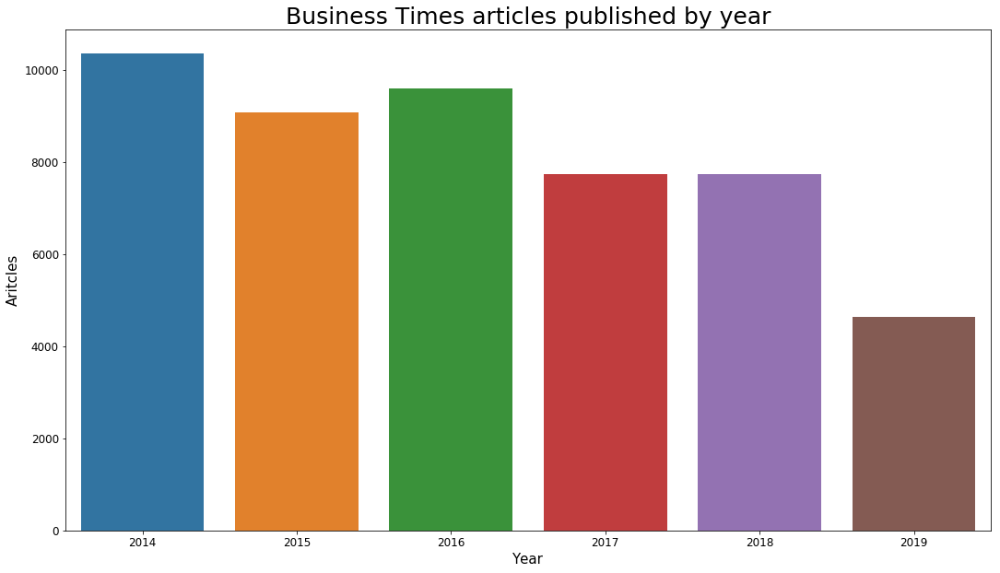

In [191]:
plt.figure(figsize=(18,10))
sns.barplot(years, [bt_combined.date.dt.year.value_counts().loc[year] for year in years]) #plotting years as x, list of value counts using list comprehension and the years defined in earlier cell
plt.title('Business Times articles published by year', fontsize=25)
plt.xlabel('Year', fontsize=15)
plt.ylabel('Articles', fontsize=15)
plt.tick_params(labelsize=12)

The number of articles published by BT has dropped significantly from 2017 onwards. 

### Save to `csv`

In [195]:
bt_combined.to_csv(r'../datasets/bt/bt_combined.csv') 